### Keras implementation of Brain CNN

In [1]:
import tensorflow as tf
import numpy as np
import sklearn.metrics

from keras.utils.np_utils import to_categorical 
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten
from keras.layers.convolutional import Convolution2D, Conv2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.normalization import BatchNormalization
from keras.optimizers import SGD
from keras.optimizers import Adam
from keras.regularizers import l2
from keras.callbacks import ModelCheckpoint
from keras.callbacks import Callback

from sklearn.model_selection import train_test_split

Using TensorFlow backend.


In [2]:
IMG_WIDTH = 64
IMG_HEIGHT = 64
SNAPS = 8 ##Number of snaps over 4 seconds
STRIP_DEPTH = 8
# STRIP_WIDTH = IMG_WIDTH * SNAPS
# STRIP_HEIGHT = IMG_HEIGHT * STRIP_DEPTH
SLICE = 1
CHANNELS = 1
CLASSES = 2
conv1_filter = 4
conv2_filter = 8
conv3_filter = 16
conv4_filter = 32
conv5_filter = 4
conv6_filter = 4

In [3]:
experiment = 's8snap'
path = '/work/aaung/datasets/' + experiment + '/'

### Leave on example out validation

In [4]:
subjects = [4847, 4799, 4820, 5675, 5680, 5710]

images = [np.load(path + str(subject) + '_' + experiment + '-image.npy') for subject in subjects]
labels = [np.load(path + str(subject) + '_' + experiment + '-label-onehot.npy') for subject in subjects]

images = np.concatenate(images, axis=0)
labels = np.concatenate(labels, axis=0)

train_img, val_img, train_lbl, val_lbl = train_test_split(images, labels, test_size = 0.2, stratify=labels)

In [5]:
print train_img.shape
print val_img.shape
print train_lbl.shape
print val_lbl.shape

(384, 408, 336)
(96, 408, 336)
(384, 2)
(96, 2)


(384, 408, 336)


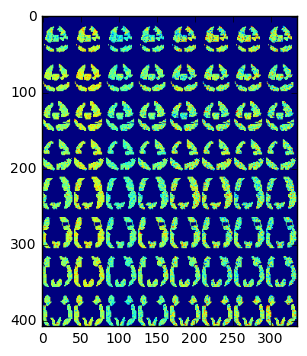

In [6]:
%matplotlib inline
import matplotlib.pyplot as plt

plt.imshow(train_img[1,:,:])
print train_img.shape

In [7]:
STRIP_HEIGHT = train_img.shape[1]
STRIP_WIDTH = train_img.shape[2]

In [8]:
class EvaluateValidation(Callback):      
    def __init__(self, test_data):
        self.test_data = test_data

    def on_epoch_end(self, epoch, logs={}):
        x, y = self.test_data
        loss, acc = self.model.evaluate(x, y, verbose=0)
        print('\nValidation loss: {}, acc: {}\n'.format(loss, acc))

In [9]:
np.random.seed(0)
# shuffle = np.random.permutation(database.shape[0])

# test = database[shuffle[0:100],:]
# val = database[shuffle[100:200],:]
# train = database[shuffle[200:],:]

xtrain = np.reshape(train_img, (train_img.shape[0], train_img.shape[1], train_img.shape[2], 1))
ytrain = train_lbl

xval = np.reshape(val_img, (val_img.shape[0], val_img.shape[1], val_img.shape[2], 1))
yval = val_lbl

### Model ###                                                                                                                               
model = Sequential()
mde = 0                                                                                                                                                                      
k_init = 'he_normal'
ridge = 0.0002

model.add(Convolution2D(conv1_filter, kernel_size=(15, 15), strides=(1, 1),
                        padding='same', data_format="channels_last", activation=None, use_bias=True,
                        kernel_regularizer=l2(ridge),
                        kernel_initializer=k_init, bias_initializer='zeros', input_shape=(STRIP_HEIGHT, STRIP_WIDTH, CHANNELS)))                                                                                                   
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Convolution2D(conv2_filter, kernel_size=(17, 17), strides=(1, 1),
                        padding='same', data_format="channels_last", activation=None, use_bias=True,
                        kernel_regularizer=l2(ridge),
                        kernel_initializer=k_init, bias_initializer='zeros'))                                                                                                   
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(MaxPooling2D(pool_size = (2, 2), strides=(2, 2), padding='valid'))

model.add(Convolution2D(conv3_filter, kernel_size=(22, 22), strides=(1, 1),
                        padding='same', data_format="channels_last", activation=None, use_bias=True,
                        kernel_regularizer=l2(ridge),
                        kernel_initializer=k_init, bias_initializer='zeros'))                                                                                                   
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(Convolution2D(conv4_filter, kernel_size=(25, 25), strides=(1, 1),
                        padding='same', data_format="channels_last", activation=None, use_bias=True,
                        kernel_regularizer=l2(ridge),
                        kernel_initializer=k_init, bias_initializer='zeros'))                                                                                                   
model.add(BatchNormalization())
model.add(Activation('relu'))

model.add(MaxPooling2D(pool_size = (2, 2), strides=2, padding='valid'))

model.add(Flatten())
model.add(Dense(1024, kernel_initializer=k_init,kernel_regularizer=l2(ridge)))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dense(512, kernel_initializer=k_init,kernel_regularizer=l2(ridge)))
# model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dense(256, kernel_initializer=k_init,kernel_regularizer=l2(ridge)))
# model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dense(CLASSES, kernel_initializer=k_init,kernel_regularizer=l2(ridge)))
# model.add(BatchNormalization())
model.add(Activation('softmax'))

Lr = 1e-4 
dcy = 1e-5                                                                                                                                                                                
m = 0.5
batch_sz = 20
epoch = 15
# sgd = SGD(lr=Lr, momentum=m, decay=dcy,  nesterov=True)
adam = Adam(lr=Lr, decay=dcy)

model.compile(optimizer = adam, loss = 'categorical_crossentropy', metrics = ['accuracy'])

model.summary()
print('learning rate: %f, decay: %f' %(Lr, dcy))

from keras.backend import get_session
get_session().run(tf.global_variables_initializer())
a = model.fit(xtrain, ytrain, batch_size = batch_sz, epochs= epoch, verbose = 1,
              callbacks=[EvaluateValidation((xval, yval))])

loss_and_metrics = model.evaluate(xval, yval, batch_size=batch_sz)

print "Loss and accuracy: ", loss_and_metrics

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 408, 336, 4)       904       
_________________________________________________________________
batch_normalization_1 (Batch (None, 408, 336, 4)       16        
_________________________________________________________________
activation_1 (Activation)    (None, 408, 336, 4)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 408, 336, 8)       9256      
_________________________________________________________________
batch_normalization_2 (Batch (None, 408, 336, 8)       32        
_________________________________________________________________
activation_2 (Activation)    (None, 408, 336, 8)       0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 204, 168, 8)       0         
__________

In [10]:
y_pred_one_hot = model.predict(xval, batch_size=128)
y_pred = np.argmax(y_pred_one_hot, axis=1)

In [11]:
y_true = np.argmax(yval, axis=1)

In [12]:
print "Precision", sklearn.metrics.precision_score(y_true, y_pred)
print "Recall", sklearn.metrics.recall_score(y_true, y_pred)
print "f1_score", sklearn.metrics.f1_score(y_true, y_pred)
print "confusion_matrix"
print sklearn.metrics.confusion_matrix(y_true, y_pred, labels=[0, 1])
fpr, tpr, tresholds = sklearn.metrics.roc_curve(y_true, y_pred)
ras = sklearn.metrics.auc(fpr, tpr)
roauc_score = sklearn.metrics.roc_auc_score(y_true, y_pred)
print ras
print roauc_score

Precision 0.564516129032
Recall 0.921052631579
f1_score 0.7
confusion_matrix
[[31 27]
 [ 3 35]]
0.7277676951
0.7277676951


In [13]:
print "{}".format(loss_and_metrics[0])
print "{}".format(loss_and_metrics[1] * 100)
print sklearn.metrics.precision_score(y_true, y_pred)
print sklearn.metrics.recall_score(y_true, y_pred)
print sklearn.metrics.f1_score(y_true, y_pred)
print sklearn.metrics.confusion_matrix(y_true, y_pred, labels=[0, 1])



# Compute ROC curve and ROC area for each class
n_classes = 2
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = sklearn.metrics.roc_curve(yval[:, i], y_pred_one_hot[:, i])
    roc_auc[i] = sklearn.metrics.auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = sklearn.metrics.roc_curve(yval.ravel(), y_pred_one_hot.ravel())
roc_auc["micro"] = sklearn.metrics.auc(fpr["micro"], tpr["micro"])

roauc_score = sklearn.metrics.roc_auc_score(y_true, y_pred)

print roauc_score


1.53911732137
68.7500027319
0.564516129032
0.921052631579
0.7
[[31 27]
 [ 3 35]]
0.7277676951


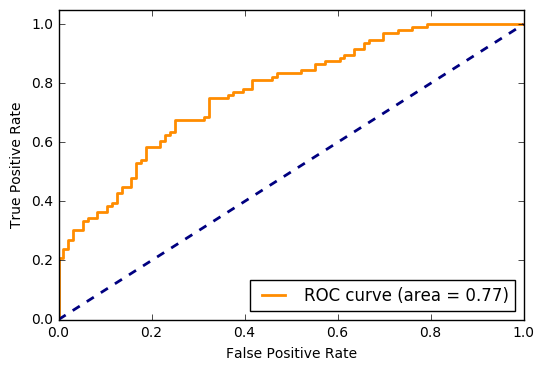

In [14]:
plt.figure()
lw = 2
plt.plot(fpr["micro"], tpr["micro"], color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc["micro"])
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# plt.title('ROC classifying Faces of class {} (Pure class {} vs Mixed class {})'.format(CLASS, CLASS, CLASS))
plt.legend(loc="lower right")
plt.show()

In [15]:
print tpr["micro"]
print fpr["micro"]

[ 0.01041667  0.20833333  0.20833333  0.23958333  0.23958333  0.27083333
  0.27083333  0.30208333  0.30208333  0.33333333  0.33333333  0.34375
  0.34375     0.36458333  0.36458333  0.38541667  0.38541667  0.39583333
  0.39583333  0.42708333  0.42708333  0.44791667  0.44791667  0.47916667
  0.47916667  0.5         0.53125     0.53125     0.54166667  0.54166667
  0.5625      0.58333333  0.58333333  0.58333333  0.60416667  0.60416667
  0.625       0.625       0.63541667  0.63541667  0.64583333  0.66666667
  0.67708333  0.67708333  0.6875      0.6875      0.75        0.75        0.75
  0.75        0.76041667  0.76041667  0.77083333  0.77083333  0.78125
  0.78125     0.80208333  0.8125      0.8125      0.8125      0.82291667
  0.82291667  0.83333333  0.83333333  0.83333333  0.84375     0.84375
  0.86458333  0.86458333  0.875       0.875       0.88541667  0.88541667
  0.89583333  0.89583333  0.91666667  0.91666667  0.9375      0.9375
  0.94791667  0.94791667  0.96875     0.96875     0.979166

In [16]:
i = 0 
for layer in model.layers:
    print "{}: {}".format(i, layer)
    i += 1

0: <keras.layers.convolutional.Conv2D object at 0x2aab541f0e50>
1: <keras.layers.normalization.BatchNormalization object at 0x2aab541f0dd0>
2: <keras.layers.core.Activation object at 0x2aab541fa710>
3: <keras.layers.convolutional.Conv2D object at 0x2aab541fa290>
4: <keras.layers.normalization.BatchNormalization object at 0x2aab54274f50>
5: <keras.layers.core.Activation object at 0x2aab54957c10>
6: <keras.layers.pooling.MaxPooling2D object at 0x2aab54949b50>
7: <keras.layers.convolutional.Conv2D object at 0x2aab549687d0>
8: <keras.layers.normalization.BatchNormalization object at 0x2aab54986ed0>
9: <keras.layers.core.Activation object at 0x2aab54a705d0>
10: <keras.layers.convolutional.Conv2D object at 0x2aab54a9d2d0>
11: <keras.layers.normalization.BatchNormalization object at 0x2aab54a12ad0>
12: <keras.layers.core.Activation object at 0x2aab54bd0b10>
13: <keras.layers.pooling.MaxPooling2D object at 0x2aab54c2a690>
14: <keras.layers.core.Flatten object at 0x2aab54a8cfd0>
15: <keras.laye

In [17]:
# def draw_10(arr):
#     arr_shape = arr.shape
#     loop_count = arr_shape[3] * arr_shape[2]
#     if  loop_count > 10:
#         loop_count = 10 
#     fig, axes = plt.subplots(1, loop_count, figsize=(10, 4))
#     for i in range(loop_count):
#         for kernel in range(arr[3]):
#             for depth in range(arr[2]):
#                 axes[i].axis('off')
#                 axes[i].imshow(kern_weight[:,:,depth,kernel], cmap = 'gray')

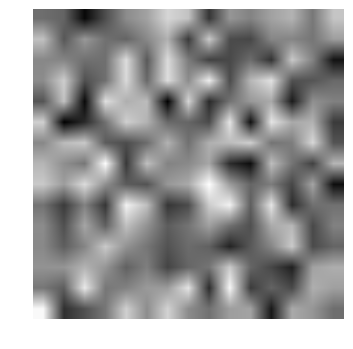

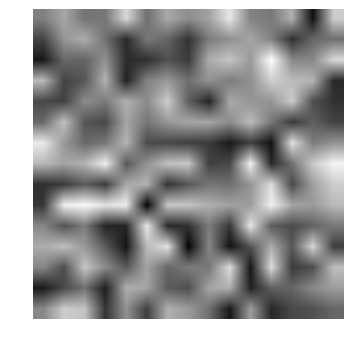

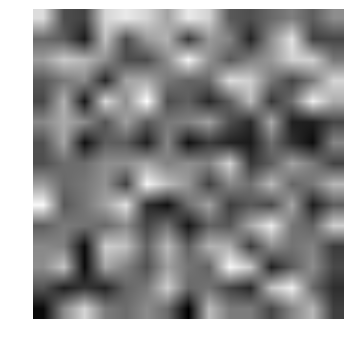

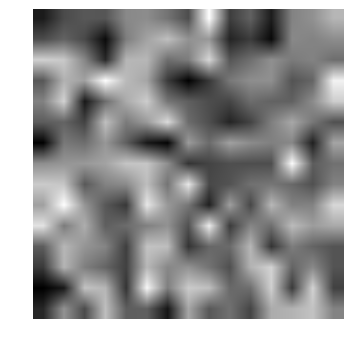

In [18]:
layer = 0
arr = np.array(model.layers[layer].get_weights())[0].shape
kern_weight = np.array(model.layers[layer].get_weights())[0]
i = 0
for kernel in range(arr[3]):
    for depth in range(arr[2]):
        plt.axis('off')
        plt.show(plt.imshow(kern_weight[:,:,depth,kernel], cmap='gray'))
        i += 1
        if i == 5:
            break

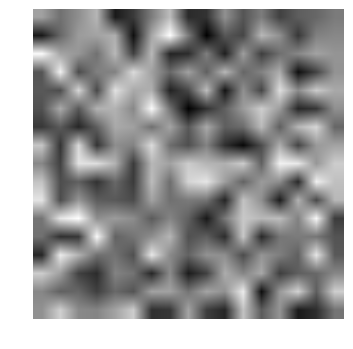

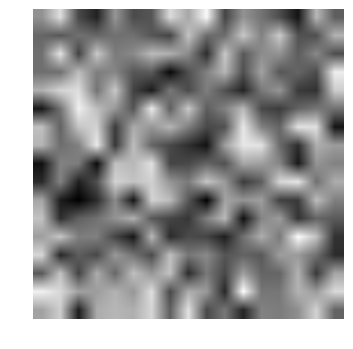

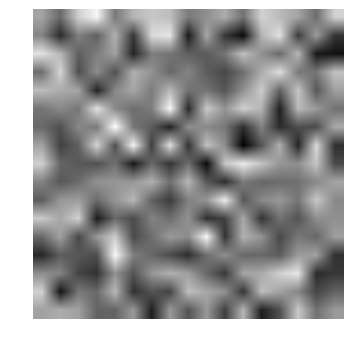

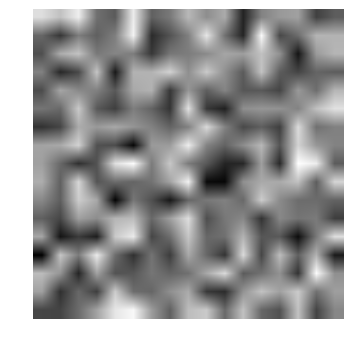

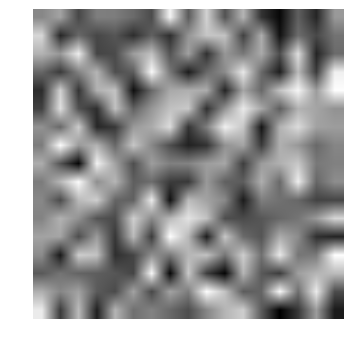

...

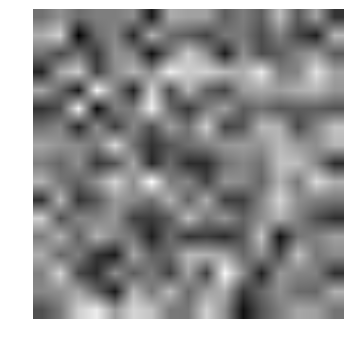

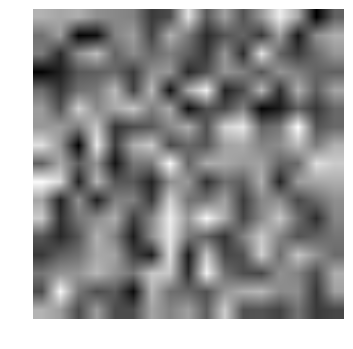

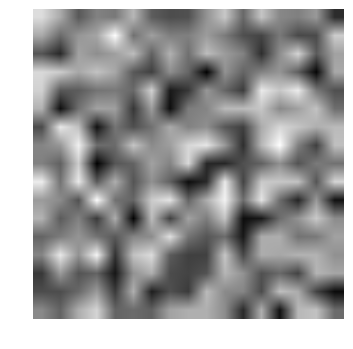

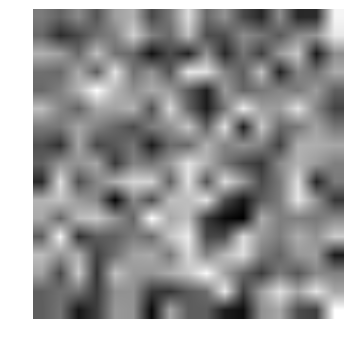

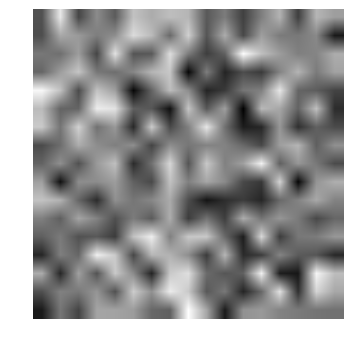

In [19]:
layer = 3
arr = np.array(model.layers[layer].get_weights())[0].shape
kern_weight = np.array(model.layers[layer].get_weights())[0]
i = 0
for kernel in range(arr[3]):
    for depth in range(arr[2]):
        plt.axis('off')
        plt.show(plt.imshow(kern_weight[:,:,depth,kernel], cmap='gray'))
        i += 1
        if i == 5:
            break

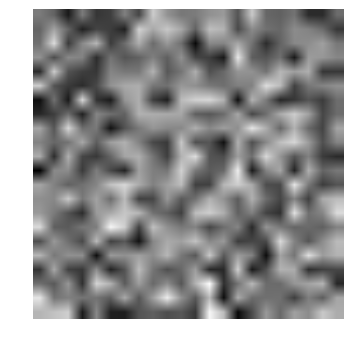

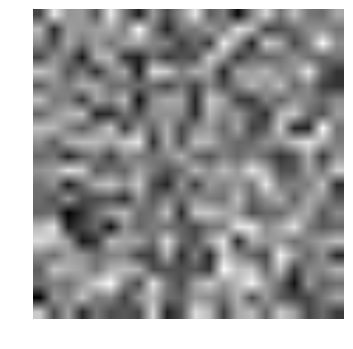

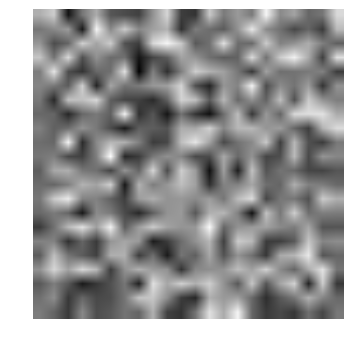

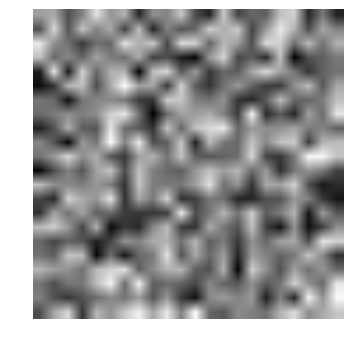

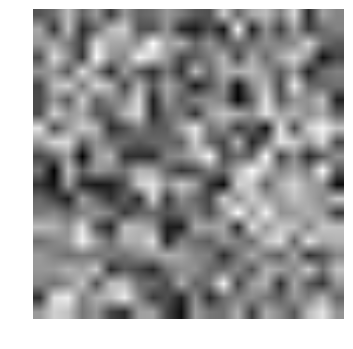

...

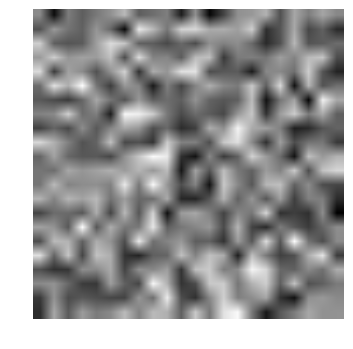

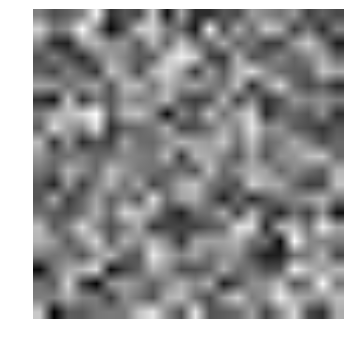

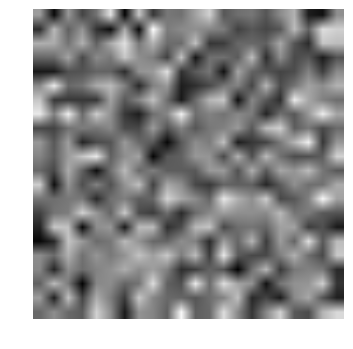

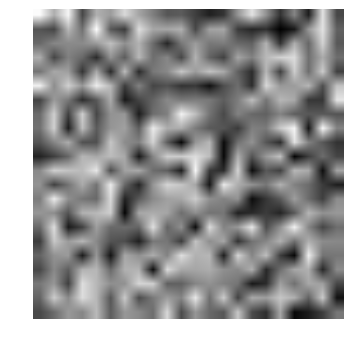

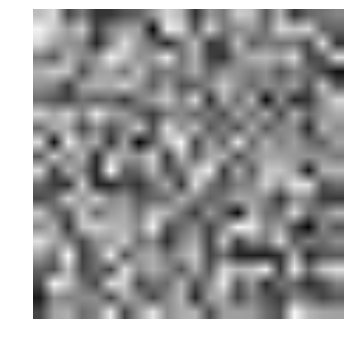

In [20]:
layer = 7
arr = np.array(model.layers[layer].get_weights())[0].shape
kern_weight = np.array(model.layers[layer].get_weights())[0]
i = 0
for kernel in range(arr[3]):
    for depth in range(arr[2]):
        plt.axis('off')
        plt.show(plt.imshow(kern_weight[:,:,depth,kernel], cmap='gray'))
        i += 1
        if i == 5:
            break

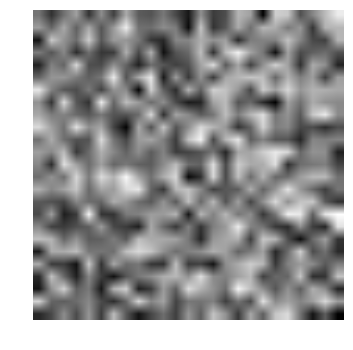

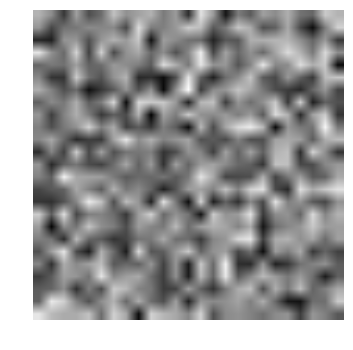

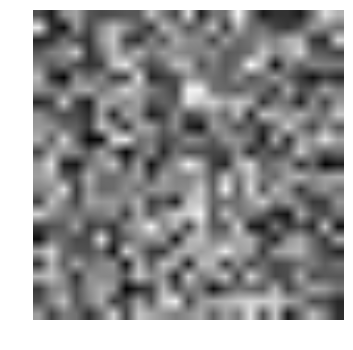

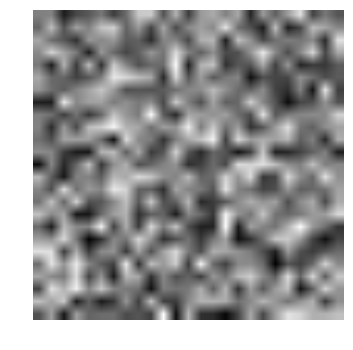

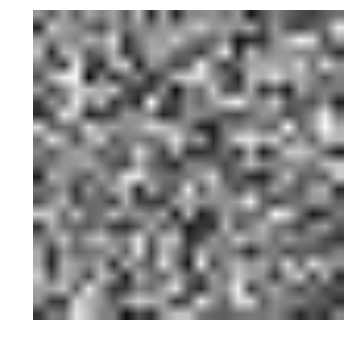

...

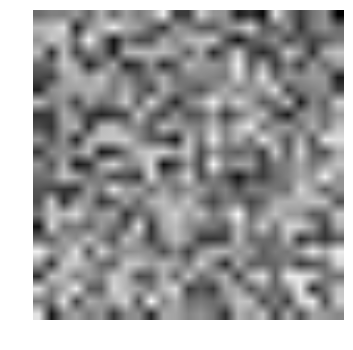

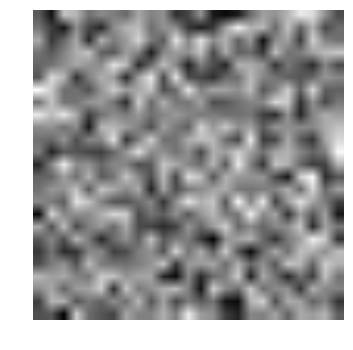

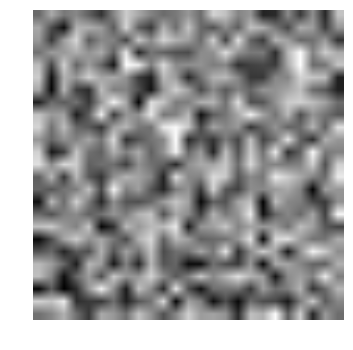

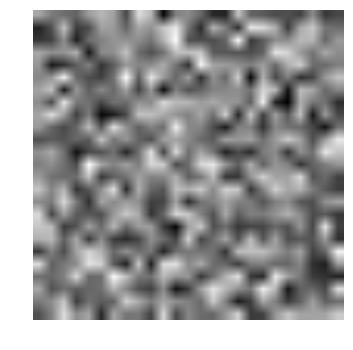

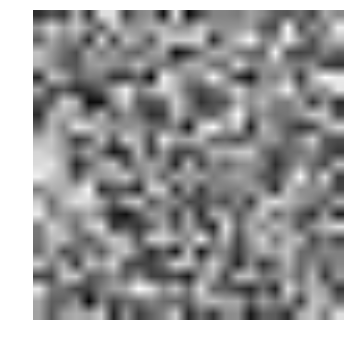

In [21]:
layer = 10
arr = np.array(model.layers[layer].get_weights())[0].shape
kern_weight = np.array(model.layers[layer].get_weights())[0]
i = 0
for kernel in range(arr[3]):
    for depth in range(arr[2]):
        plt.axis('off')
        plt.show(plt.imshow(kern_weight[:,:,depth,kernel], cmap='gray'))
        i += 1
        if i == 5:
            break